In [3]:
import pandas as pd
import numpy as np
import yfinance as yf
import matplotlib.pyplot as plt
import datetime as dt
import seaborn as sns
from scipy.stats import norm
from scipy.stats import t,  beta
from warnings import filterwarnings
filterwarnings('ignore')
from scipy.stats import cauchy
from itertools import combinations
from statsmodels.distributions.empirical_distribution import ECDF
from copulas.multivariate import GaussianMultivariate
from mpl_toolkits.mplot3d import Axes3D
from copulas.bivariate import Clayton
from copulas.multivariate import VineCopula

In [4]:
end_date = dt.datetime(2025, 3, 1)
start_date = end_date - dt.timedelta(days=365*6)

In [5]:
tickers =['^NBI','^IXIC','^GSPC','^RUT', 'BTC-USD','^DJI']

In [6]:
quotes = pd.DataFrame()
for ticker in tickers:
  quotes[ticker] = yf.download(ticker, start_date, end_date)['Close']

quotes = quotes.dropna()

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


In [7]:
log_return = np.log(quotes/quotes.shift(1)).dropna()

In [ ]:
Skewness =  log_return.skew()
Kurtosis = log_return.kurt()
mean = log_return.mean()
std = log_return.std()
pd.DataFrame({'Skewness': Skewness, 'Kurtosis': Kurtosis, 'Mean': mean, 'Standard Deviation': std})

,Skewness,Kurtosis,Mean,Standard Deviation
^NBI,-0.265027,3.429429,0.000154,0.015098
^IXIC,-0.650043,7.336789,0.000605,0.015274
^GSPC,-0.852855,15.294763,0.000502,0.012725
^RUT,-0.896546,10.032583,0.000210,0.016725
BTC-USD,-0.949588,13.452343,0.002064,0.041727
^DJI,-1.018055,23.406636,0.000351,0.012393


In [8]:
log_return_cdf = log_return.apply(lambda col:ECDF(col))
transcdf = log_return.apply(lambda col:log_return_cdf[col.name](col))

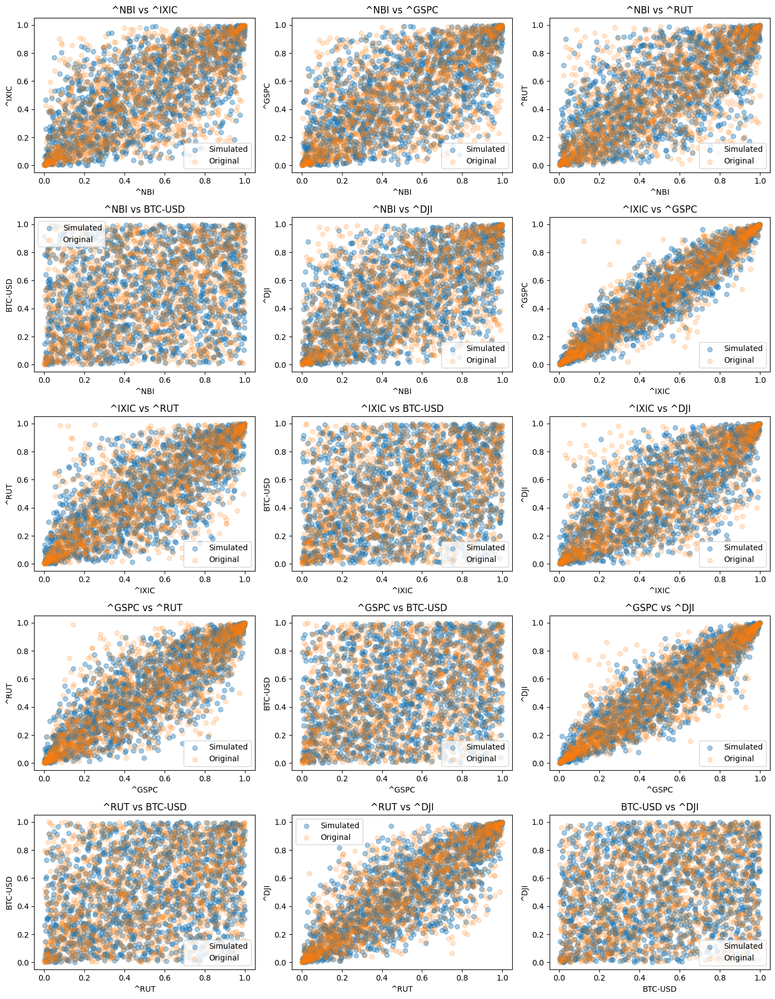

In [9]:
#Gaussian Copula
copula = GaussianMultivariate()
copula.fit(transcdf)
synthetic_data = copula.sample(len(transcdf))

"""To determine if the Gaussian copula can effectively explain the relationship between variables, we are plotting both the simulated samples and the actual observations. From the scatter plot, we observe that the Gaussian copula closely matches the real observations. Additionally, the 3-D plots also further demonstrate a good approximation of the data."""

def plotter(df):
  variables = list(quotes.columns)
  pairs = list(combinations(variables, 2))
  fig, axes = plt.subplots(5,3, figsize=(14,18))
  axes = axes.flatten()

  for i, (var1, var2) in enumerate(pairs):
    axes[i].scatter(df[var1], df[var2], label ='Simulated', alpha=0.4)
    axes[i].scatter(transcdf[var1], transcdf[var2], label ='Original', alpha=0.2)
    axes[i].set_xlabel(var1)
    axes[i].set_ylabel(var2)
    axes[i].set_title(f'{var1} vs {var2}')
    axes[i].legend()

  plt.tight_layout()
  plt.show()

plotter(synthetic_data)

In [10]:
copula.correlation

,^NBI,^IXIC,^GSPC,^RUT,BTC-USD,^DJI
^NBI,1.000000,0.703241,0.671252,0.713659,0.243929,0.613028
^IXIC,0.703241,1.000000,0.940931,0.783524,0.319324,0.782262
^GSPC,0.671252,0.940931,1.000000,0.846139,0.289498,0.923133
^RUT,0.713659,0.783524,0.846139,1.000000,0.311268,0.836943
BTC-USD,0.243929,0.319324,0.289498,0.311268,1.000000,0.250303
^DJI,0.613028,0.782262,0.923133,0.836943,0.250303,1.000000


In [11]:
def plotter_3d(df):
    variables = list(df.columns)
    pairs = list(combinations(variables, 3))
    fig, axes = plt.subplots(5, 4, figsize=(16, 22), subplot_kw={'projection': '3d'})
    axes = axes.flatten()

    for i, (var1, var2, var3) in enumerate(pairs):
        axes[i].scatter(df[var1], df[var2], df[var3], label='Simulated', alpha=0.4)
        axes[i].scatter(transcdf[var1], transcdf[var2], transcdf[var3], label='Original', alpha=0.4)
        axes[i].set_xlabel(var1)
        axes[i].set_ylabel(var2)
        axes[i].set_zlabel(var3)
        axes[i].set_title(f'{var1} vs {var2} vs {var3}')
        axes[i].legend()

    plt.tight_layout()
    plt.show()

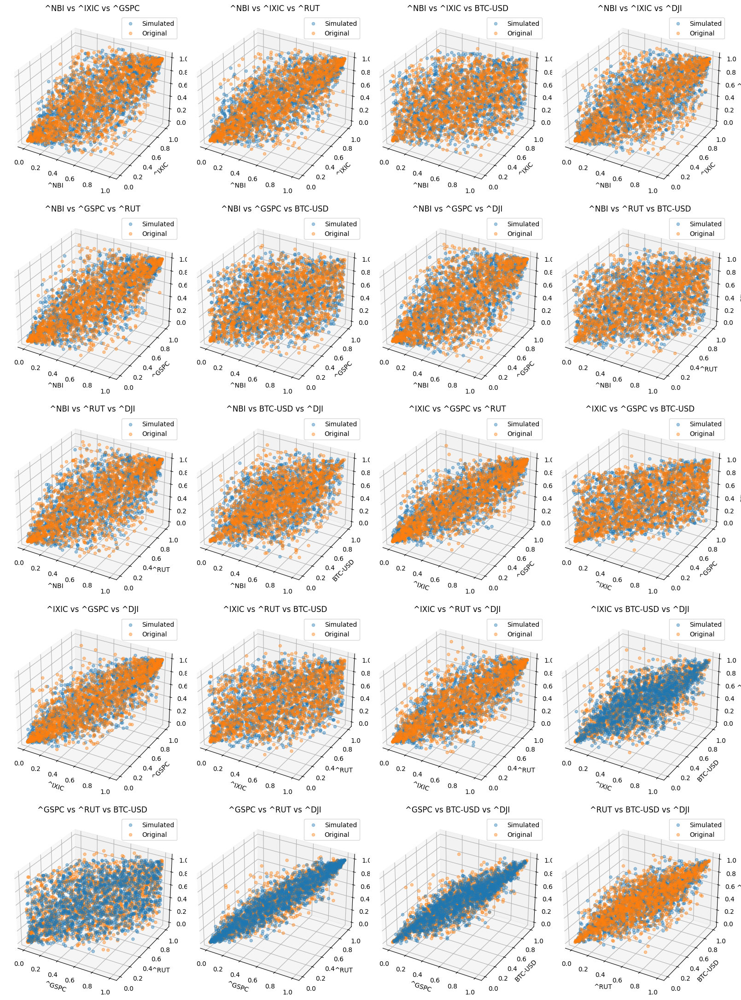

In [12]:
plotter_3d(synthetic_data)

Tree 1:
L:3 R:4 D:set() Copula:CopulaTypes.FRANK Theta:1.9020787589518042
L:0 R:3 D:set() Copula:CopulaTypes.FRANK Theta:5.914157984370666
L:0 R:1 D:set() Copula:CopulaTypes.FRANK Theta:5.321998646043568
L:1 R:2 D:set() Copula:CopulaTypes.FRANK Theta:16.747655826417187
L:2 R:5 D:set() Copula:CopulaTypes.FRANK Theta:13.48115100759769
Tree 2:
L:0 R:4 D:{np.int64(3)} Copula:CopulaTypes.GUMBEL Theta:1.0271335651714257
L:1 R:3 D:{np.int64(0)} Copula:CopulaTypes.FRANK Theta:4.387888870427993
L:0 R:2 D:{np.int64(1)} Copula:CopulaTypes.FRANK Theta:0.6046643289170807
L:1 R:5 D:{np.int64(2)} Copula:CopulaTypes.FRANK Theta:-4.298977048562079
Tree 3:
L:1 R:4 D:{np.int64(0), np.int64(3)} Copula:CopulaTypes.FRANK Theta:-0.3114823811133392
L:2 R:3 D:{np.int64(0), np.int64(1)} Copula:CopulaTypes.GUMBEL Theta:1.4497715669891302
L:0 R:5 D:{np.int64(1), np.int64(2)} Copula:CopulaTypes.FRANK Theta:1.6352210608052193


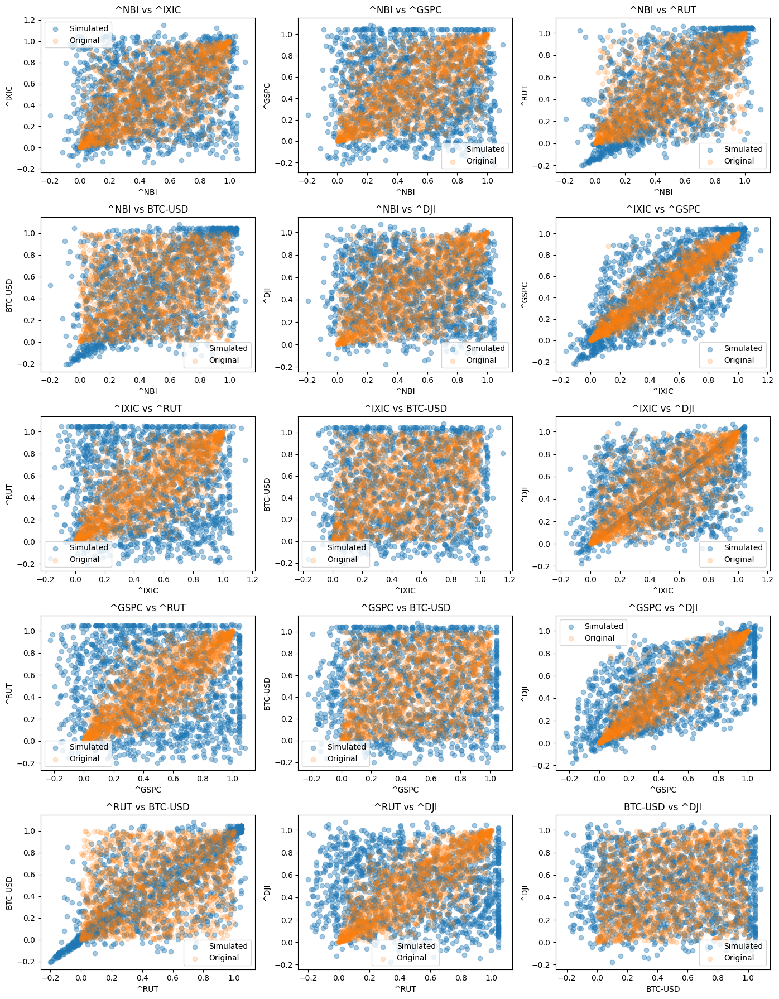

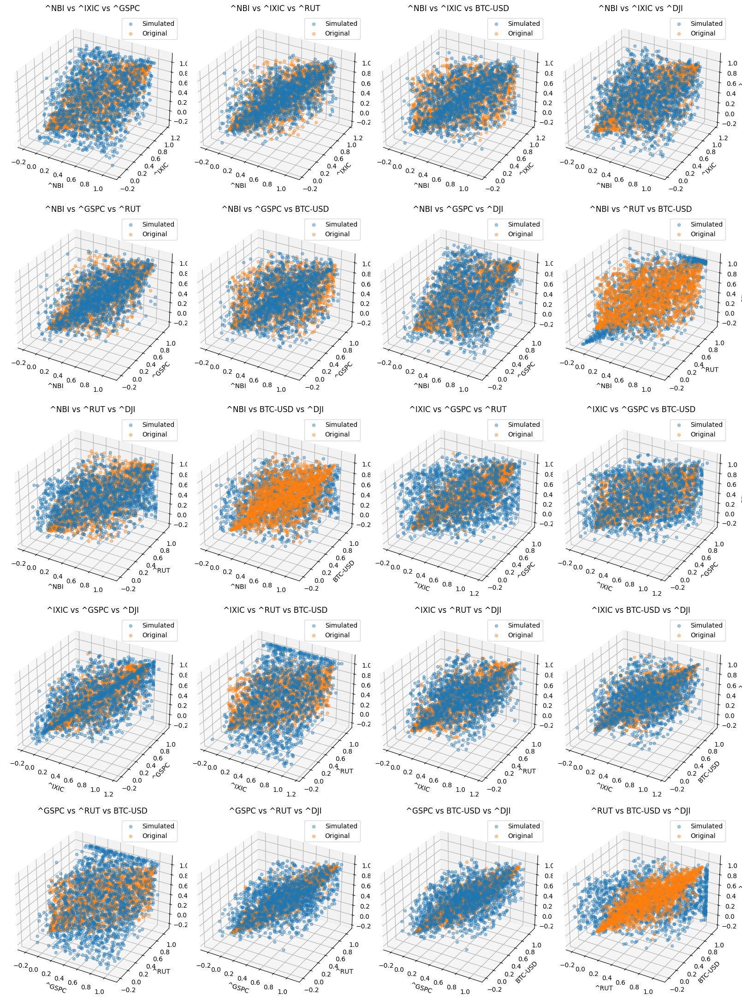

In [13]:
# VineCopula
vine_d = VineCopula('direct')
vine_d.fit(transcdf)

trees = vine_d.trees
for i, tree in enumerate(trees):
    print(f"Tree {i+1}:")
    print(tree)
vine_d_samples = vine_d.sample(len(transcdf))

plotter(vine_d_samples)
plotter_3d(vine_d_samples)

Tree 1:
L:0 R:3 D:set() Copula:CopulaTypes.FRANK Theta:5.914157984370666
L:0 R:1 D:set() Copula:CopulaTypes.FRANK Theta:5.321998646043568
L:0 R:2 D:set() Copula:CopulaTypes.FRANK Theta:4.891281631361541
L:0 R:5 D:set() Copula:CopulaTypes.FRANK Theta:4.228146828412378
L:0 R:4 D:set() Copula:CopulaTypes.FRANK Theta:1.437903447072275
Tree 2:
L:1 R:3 D:{0} Copula:CopulaTypes.FRANK Theta:4.387888870427993
L:2 R:3 D:{0} Copula:CopulaTypes.FRANK Theta:5.886976895954029
L:3 R:5 D:{0} Copula:CopulaTypes.GUMBEL Theta:2.0206396125287127
L:3 R:4 D:{0} Copula:CopulaTypes.FRANK Theta:1.3229303776945984
Tree 3:
L:1 R:2 D:{0, 3} Copula:CopulaTypes.FRANK Theta:9.411632444836577
L:1 R:5 D:{0, 3} Copula:CopulaTypes.FRANK Theta:2.543255226315708
L:1 R:4 D:{0, 3} Copula:CopulaTypes.FRANK Theta:0.7312213885555565


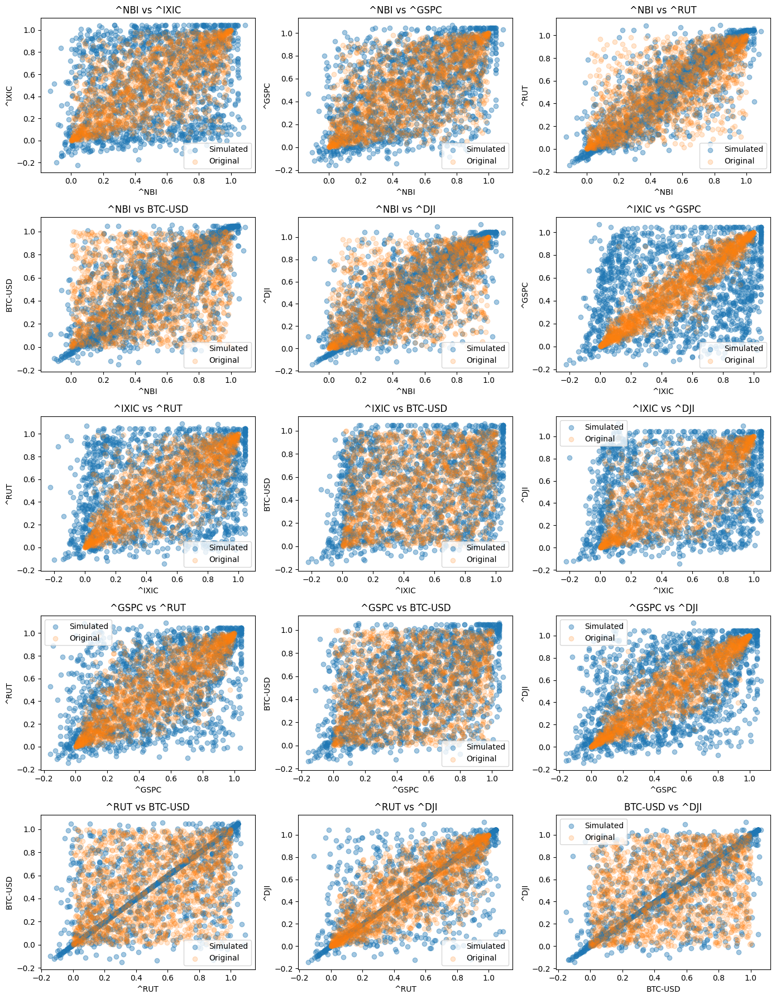

In [14]:
#C-Vine Copula
vine_c = VineCopula('center')
vine_c.fit(transcdf)

trees = vine_c.trees
for i, tree in enumerate(trees):
    print(f"Tree {i+1}:")
    print(tree)

vine_c_samples = vine_c.sample(len(transcdf))
plotter(vine_c_samples)

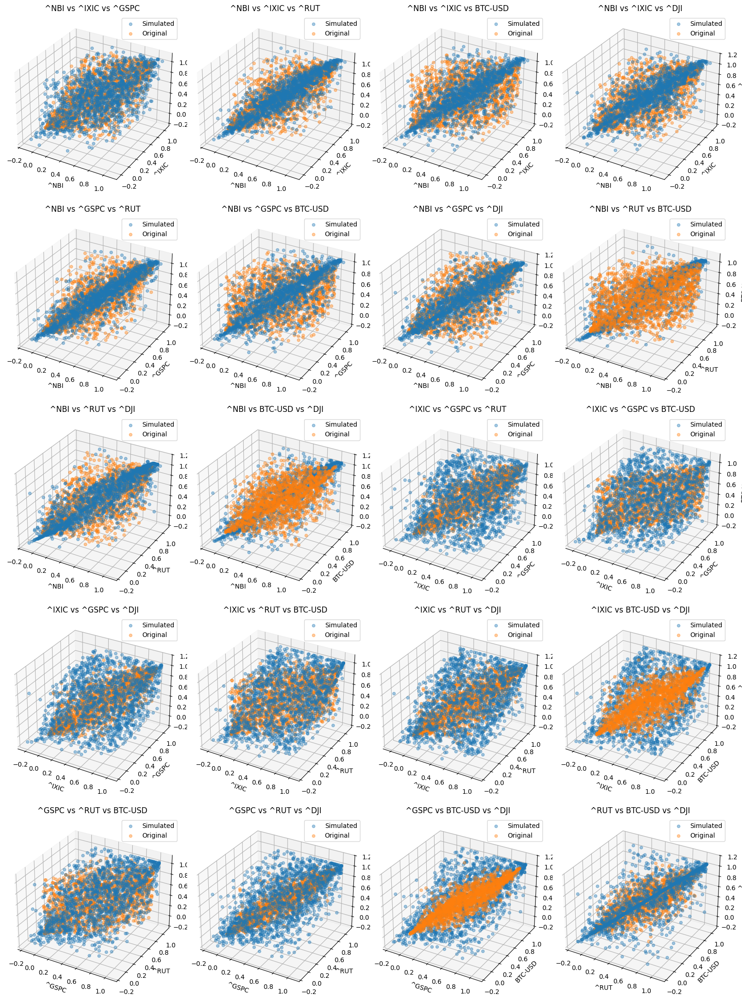

In [15]:
plotter_3d(vine_c_samples)